In [1]:
from dask.distributed import Client

client = Client("tcp://127.0.0.1:36055")
client

<Client: 'tcp://127.0.0.1:36055' processes=8 threads=32, memory=125.85 GiB>

In [2]:
import numpy as np
import xarray as xr
from MITgcmutils import rdmds
from xmitgcm import open_mdsdataset
from xgcm.grid import Grid
import os.path as op
# from xmovie import Movie
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
ddir = '/tank/spectre/RUNS/'
gdir = '/tank/spectre/RUNS/grid/'

In [7]:
#-- some parameters --
nt = 73         #also need earlier and past year for interpolation, 
                #for now it is coded in a 'normal year' fashion
# nproc = 36      #number of processors used for parallelization 

#-- time param for loading --
dt = 80                #1/12 model time step
spy = 86400*365
dump = 5*86400       #5-d dumps
d_iter = dump/dt
nDump = spy/dump

iper = 2005
offset = int((iper-2002)*spy/dt)
# iters = np.arange(d_iter, (nDump+1)*d_iter, d_iter, dtype='int') + offset
iters = (np.arange(d_iter, (nDump+1)*d_iter, d_iter, dtype='int') 
         + offset) 
# - int(d_iter)
# dd0 = 21
dd = 33
iters[dd:]

array([1366200, 1371600, 1377000, 1382400, 1387800, 1393200, 1398600,
       1404000, 1409400, 1414800, 1420200, 1425600, 1431000, 1436400,
       1441800, 1447200, 1452600, 1458000, 1463400, 1468800, 1474200,
       1479600, 1485000, 1490400, 1495800, 1501200, 1506600, 1512000,
       1517400, 1522800, 1528200, 1533600, 1539000, 1544400, 1549800,
       1555200, 1560600, 1566000, 1571400, 1576800])

In [6]:
md = 14
dsg = open_mdsdataset(op.join(ddir,'%04d/memb%03d/00' % (2003,md)), 
                      grid_dir=gdir,
                      prefix=[], 
                      delta_t=dt , iters=iters[0]                              
                     )
dsg

<xarray.Dataset> Size: 2GB
Dimensions:  (time: 1, XC: 2052, YC: 1000, XG: 2052, YG: 1000, Z: 75, Zp1: 76,
              Zu: 75, Zl: 75)
Coordinates: (12/33)
    iter     (time) int64 8B 1188000
  * time     (time) timedelta64[ns] 8B 1100 days
  * XC       (XC) >f4 8kB 278.4 278.4 278.5 278.5 ... 319.4 319.4 319.4 319.4
  * YC       (YC) >f4 4kB 25.51 25.53 25.55 25.57 ... 45.43 45.45 45.47 45.49
  * XG       (XG) >f4 8kB 278.4 278.4 278.4 278.5 ... 319.4 319.4 319.4 319.4
  * YG       (YG) >f4 4kB 25.5 25.52 25.54 25.56 ... 45.42 45.44 45.46 45.48
    ...       ...
    maskW    (Z, YC, XG) bool 154MB dask.array<chunksize=(75, 1000, 2052), meta=np.ndarray>
    maskS    (Z, YG, XC) bool 154MB dask.array<chunksize=(75, 1000, 2052), meta=np.ndarray>
    maskInC  (YC, XC) bool 2MB dask.array<chunksize=(1000, 2052), meta=np.ndarray>
    maskInS  (YG, XC) bool 2MB dask.array<chunksize=(1000, 2052), meta=np.ndarray>
    maskInW  (YC, XG) bool 2MB dask.array<chunksize=(1000, 2052), meta=np.ndarray>
    rhoRef   (Z) >f4 300B 1.021e+03 1.021e+03 1.021e+03 ... 1.044e+03 1.045e+03
Data variables:
    *empty*
Attributes:
    Conventions:  CF-1.6
    title:        netCDF wrapper of MITgcm MDS binary data
    source:       MITgcm
    history:      Created by calling `open_mdsdataset(data_dir='/tank/spectre...

In [19]:
for md in np.concatenate((np.arange(24),np.arange(36,37))):
# for md in np.arange(16):
    
    iid = 0
    for ii in iters:
        
        fname = op.join(ddir,'%4d/memb%03d/Snap%010i.zarr' 
                        % (iper,md,ii) 
                       )
        fname_new = op.join(ddir,'%4d/memb%03d_new/Snap%010i.zarr' 
                        % (iper,md,ii) 
                       )
        if op.exists(fname):
            iid += 1
        elif op.exists(fname_new):
            iid += 1
        else:
            print(fname)
        
        
    print("nmemb:", md, "# of files", iid)

nmemb: 0 # of files 73
nmemb: 1 # of files 73
nmemb: 2 # of files 73
nmemb: 3 # of files 73
nmemb: 4 # of files 73
nmemb: 5 # of files 73
nmemb: 6 # of files 73
nmemb: 7 # of files 73
nmemb: 8 # of files 73
nmemb: 9 # of files 73
nmemb: 10 # of files 73
nmemb: 11 # of files 73
nmemb: 12 # of files 73
nmemb: 13 # of files 73
nmemb: 14 # of files 73
nmemb: 15 # of files 73
nmemb: 16 # of files 73
nmemb: 17 # of files 73
nmemb: 18 # of files 73
nmemb: 19 # of files 73
nmemb: 20 # of files 73
nmemb: 21 # of files 73
nmemb: 22 # of files 73
nmemb: 23 # of files 73
/tank/spectre/RUNS/2006/memb036/Snap0001841400.zarr
/tank/spectre/RUNS/2006/memb036/Snap0001846800.zarr
/tank/spectre/RUNS/2006/memb036/Snap0001852200.zarr
/tank/spectre/RUNS/2006/memb036/Snap0001857600.zarr
/tank/spectre/RUNS/2006/memb036/Snap0001863000.zarr
nmemb: 36 # of files 68


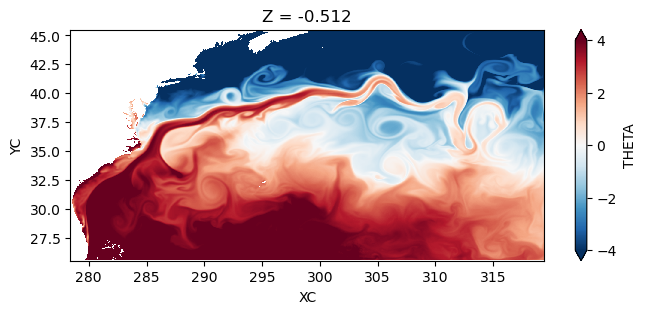

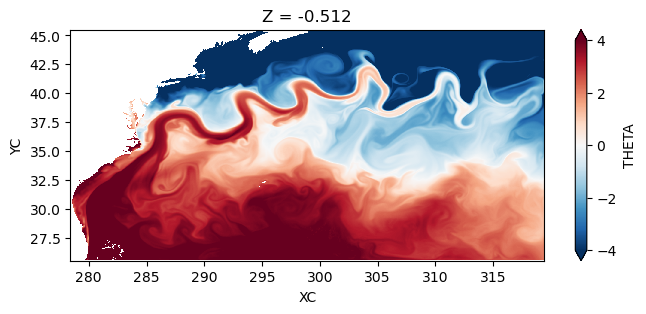

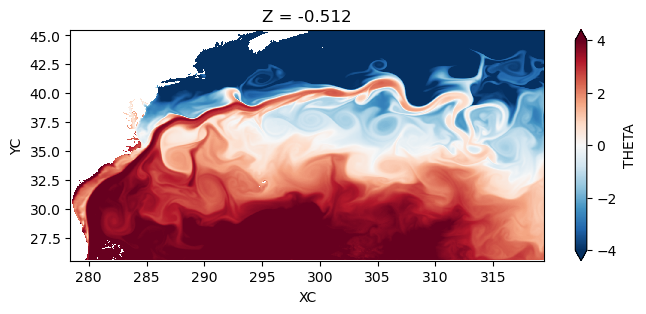

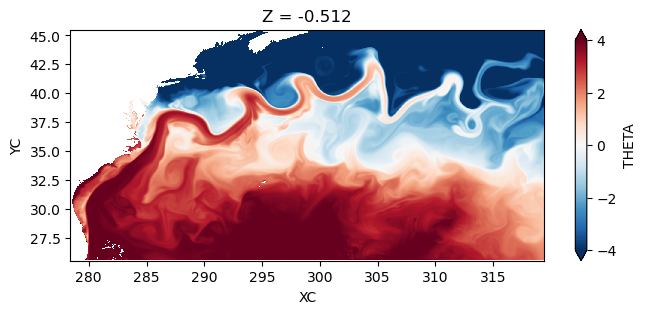

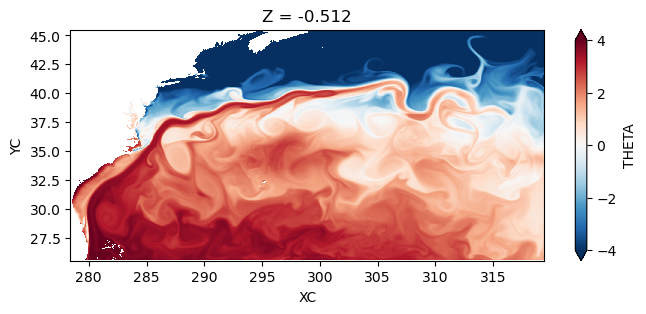

...

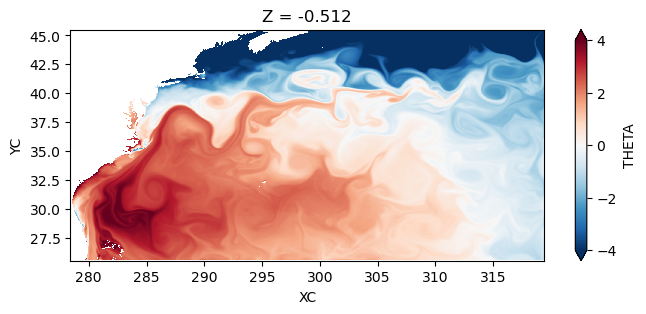

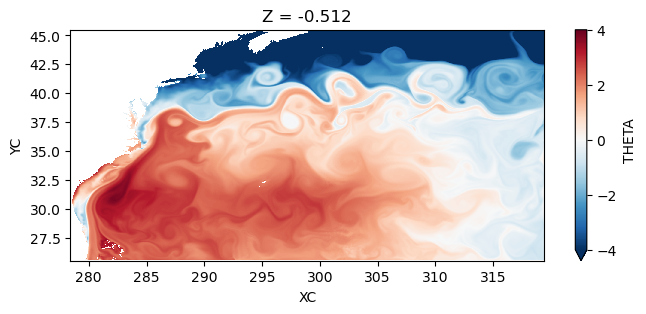

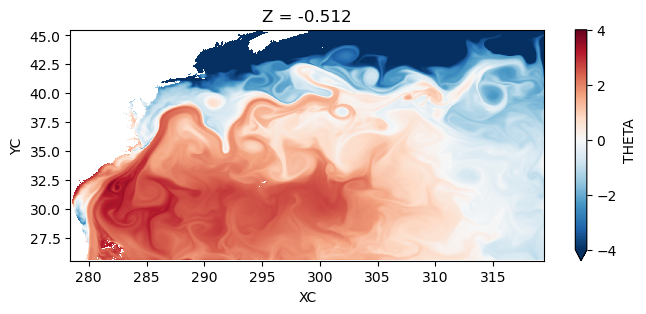

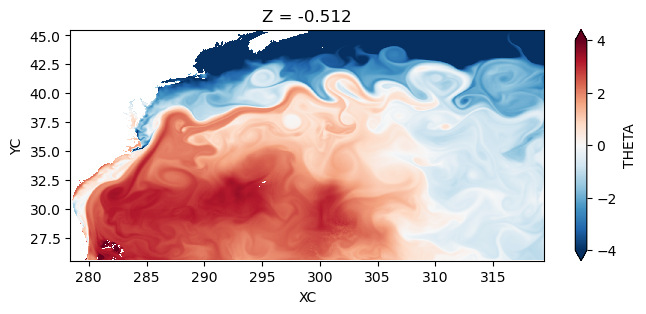

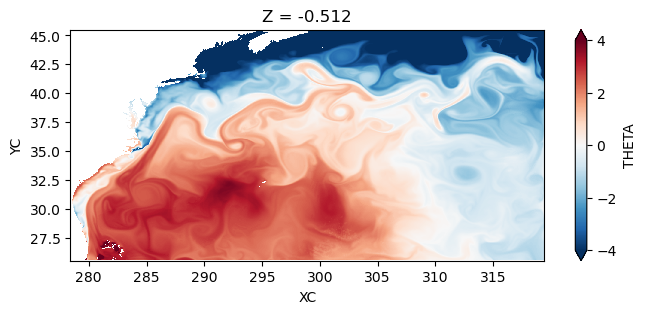

1452600 iii MISSING FILE !!!


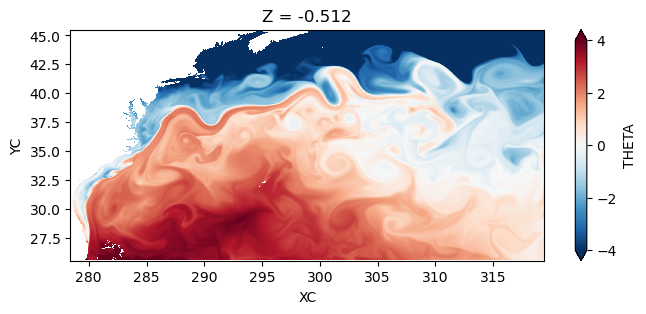

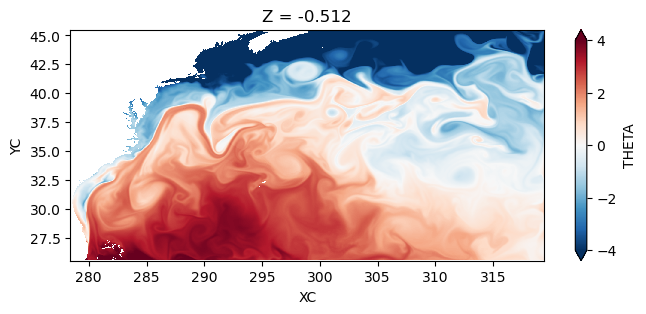

1463400 iii MISSING FILE !!!


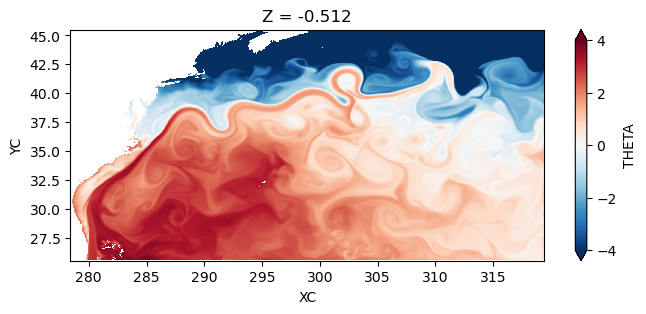

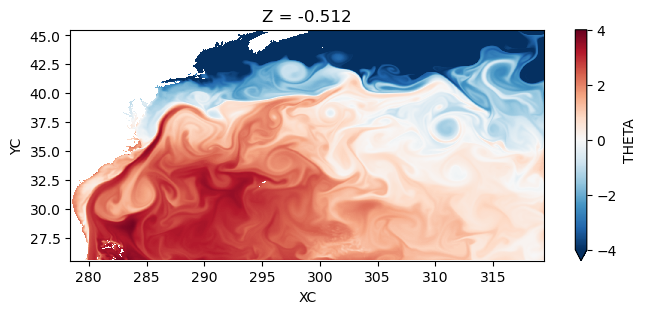

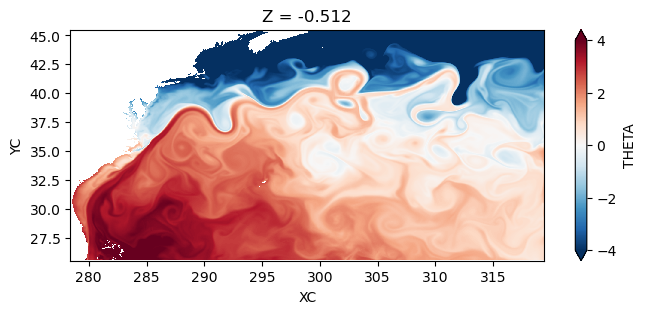

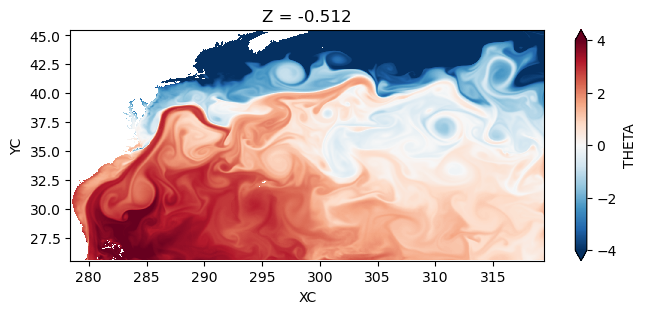

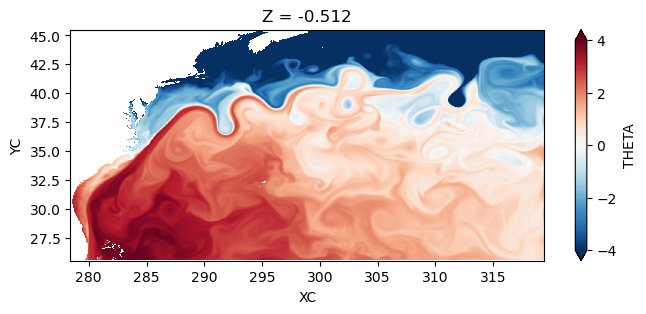

...

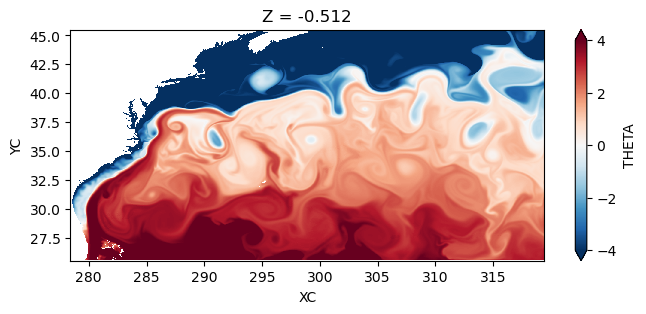

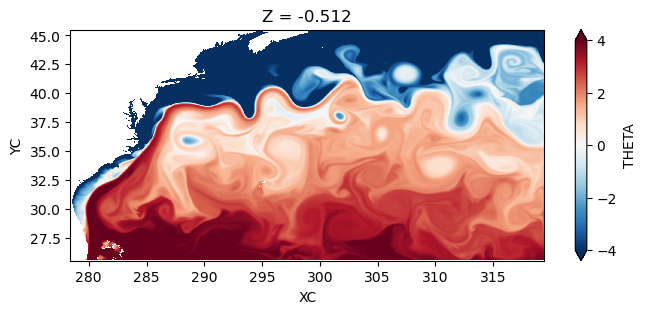

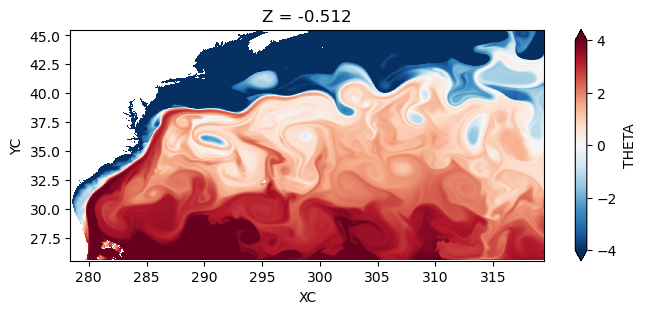

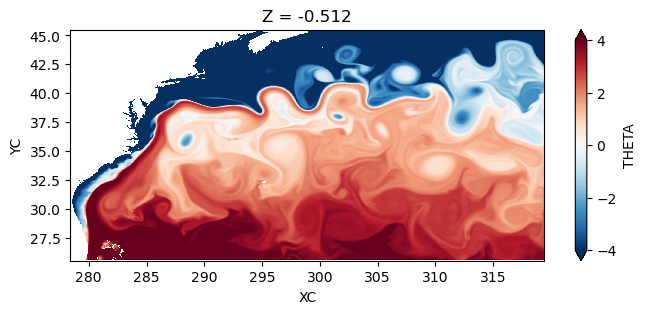

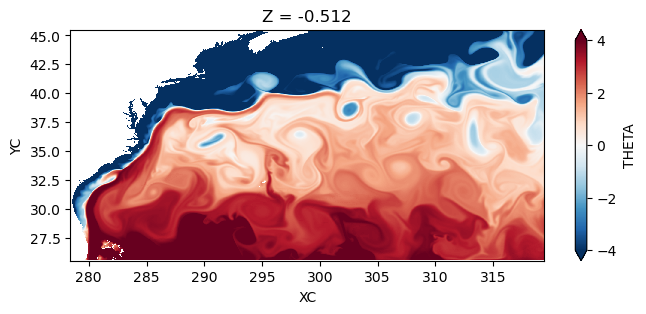

1571400 iii MISSING FILE !!!


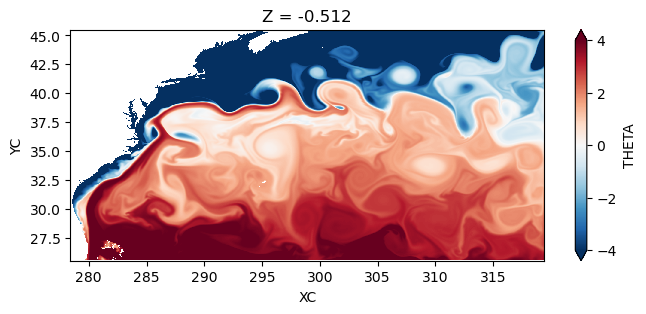

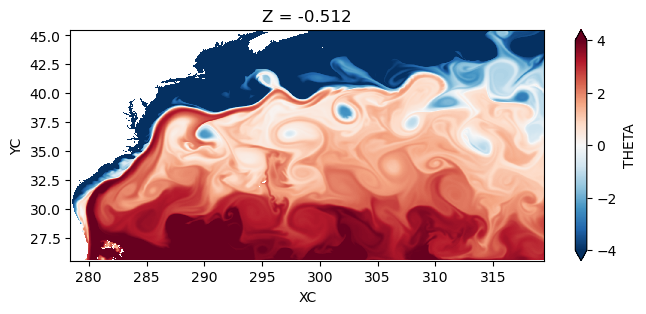

In [8]:
# ii = 1047600

# for ii in np.array([1393200]):
# for md in range(52,60):
for ii in iters[dd:]:
    # for md in range(11,12):
    for md in [15,40]:
    # for md in range(1):
        
        # fname0 = op.join(ddir,'%4d/memb%03d/pickup.%010i' 
        #                             % (iper,md,ii) 
        #                 )
        # fname1 = op.join(ddir,'%4d/memb%03d/%02d/pickup.%010i' 
        #                             % (iper,md,0,ii) 
        #                 )
        # fname2 = op.join(ddir,'%4d/memb%03d/%02d/pickup.%010i' 
        #                             % (iper,md,1,ii) 
        #                 )
        # fname3 = op.join(ddir,'%4d/memb%03d/%02d/pickup.%010i' 
        #                             % (iper,md,2,ii) 
        #                 )
        # if op.isfile(fname0+'.data'):
        #     tmpocn = rdmds( fname0 )
        # elif op.isfile(fname1+'.data'):
        #     tmpocn = rdmds( fname1 )
        # elif op.isfile(fname2+'.data'):
        #     tmpocn = rdmds( fname2 )
        # elif op.isfile(fname3+'.data'):
        #     tmpocn = rdmds( fname3 )
        # else:
        #     raise ValueError("!!!FILE MISSING!!!")
        #     break
        
        # tmpocn = rdmds( fname )
        
        try:
            fname = op.join(ddir,'%4d/memb%03d/pickup.%010i' 
                            % (iper,md,ii) 
                           )
            tmpocn = rdmds( fname )
        except:
            # fname = op.join(ddir,'%4d/memb%03d_new/pickup.%010i' 
            #                 % (iper,md,ii) 
            #                )
            # tmpocn = rdmds( fname )
            print(ii, "iii MISSING FILE !!!")
            break
        
        dsave = xr.DataArray(tmpocn[:75].astype(np.float32), 
                             dims=['Z','YC','XG'], 
                             coords={'Z':dsg.Z.data,'YC':dsg.YC.data,
                                     'XG':dsg.XG.data}
                            ).chunk({'Z':5,'YC':100,'XG':100}
                                   ).to_dataset(name='UVEL')
        dsave['VVEL'] = xr.DataArray(tmpocn[75:150].astype(np.float32), 
                                     dims=['Z','YG','XC'], 
                                     coords={'Z':dsg.Z.data,'YG':dsg.YG.data,
                                             'XC':dsg.XC.data}
                                            ).chunk({'Z':5,'YG':100,'XC':100})
        dsave['THETA'] = xr.DataArray(tmpocn[150:225].astype(np.float32), 
                                      dims=['Z','YC','XC'], 
                                     coords={'Z':dsg.Z.data,'YC':dsg.YC.data,
                                             'XC':dsg.XC.data}
                                            ).chunk({'Z':5,'YC':100,'XC':100})
        dsave['SALT'] = xr.DataArray(tmpocn[225:300].astype(np.float32), 
                                     dims=['Z','YC','XC'], 
                                     coords={'Z':dsg.Z.data,'YC':dsg.YC.data,
                                             'XC':dsg.XC.data}
                                            ).chunk({'Z':5,'YC':100,'XC':100})
        dsave.to_zarr(op.join(ddir,'%4d/memb%03d/Snap%010i.zarr' 
                              % (iper,md,ii)), mode='w'
                     )

        fig, ax = plt.subplots(figsize=(8,3))
        (dsave.THETA.isel(Z=0).where(dsg.maskInC!=0.)
         - dsave.THETA.isel(Z=0).where(dsg.maskInC!=0.).mean(skipna=True)
        ).plot(ax=ax,rasterized=True, vmax=4, vmin=-4, cmap='RdBu_r')
        ax.set_aspect('equal')
        plt.show()
        dsave.close()
        del tmpocn
        # del fname0, fname1, fname2, fname3
        del fname
        
        # print(md)

(4, 1000, 2052)


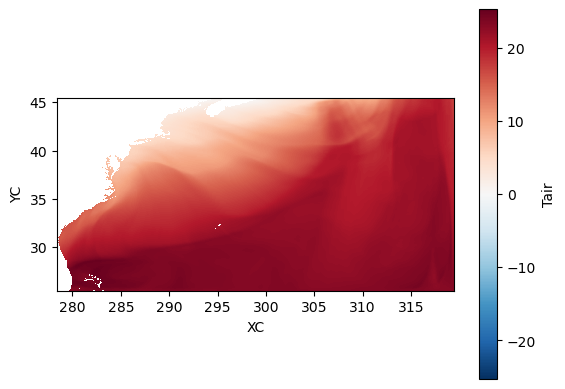

394200


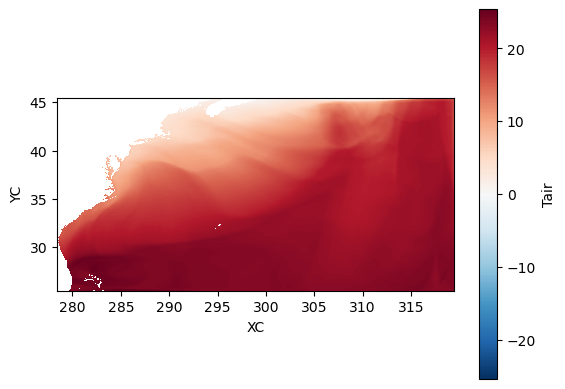

394245


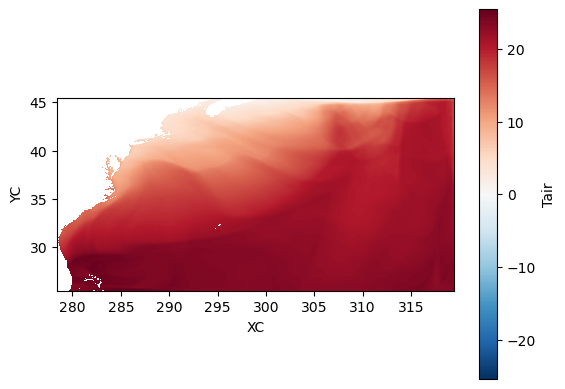

394267


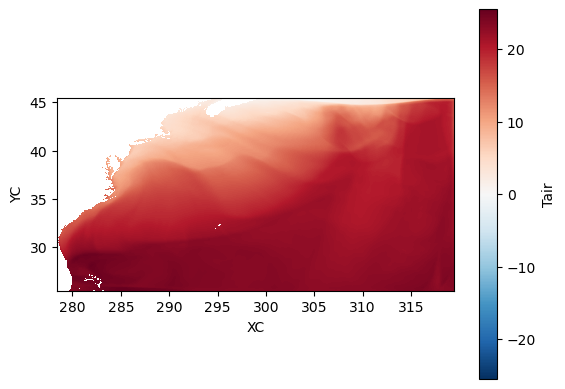

394290


In [13]:
iters = np.array([394200,394245,394267,394290])
for ii in iters:
# for ii in np.array([394200]):
    fname0 = op.join(ddir,'%4d/memb%03d/continuity/pickup_cheapaml.%010i' 
                                % (iper,0,ii) 
                    )
    if op.isfile(fname0+'.data'):
        tmpocn = rdmds( fname0 )
    else:
        raise ValueError("!!!FILE MISSING!!!")
        break
    if ii == iters[0]:
        print(tmpocn.shape)
        
    dsave = xr.DataArray(tmpocn[0].astype(np.float32), dims=['YC','XC'], 
                         coords={'YC':dsg.YC.data,'XC':dsg.XC.data}
                        ).chunk({'YC':100,'XC':100}).to_dataset(name='Tair')
    dsave['gTairNm1'] = xr.DataArray(tmpocn[1].astype(np.float32), dims=['YC','XC'], 
                         coords={'YC':dsg.YC.data,'XC':dsg.XC.data}
                                ).chunk({'YC':100,'XC':100})
    dsave['Qair'] = xr.DataArray(tmpocn[2].astype(np.float32), dims=['YC','XC'], 
                         coords={'YC':dsg.YC.data,'XC':dsg.XC.data}
                                ).chunk({'YC':100,'XC':100})
    dsave['gQairNm1'] = xr.DataArray(tmpocn[3].astype(np.float32), dims=['YC','XC'], 
                         coords={'YC':dsg.YC.data,'XC':dsg.XC.data}
                                ).chunk({'YC':100,'XC':100})
    dsave.to_zarr(op.join(ddir,'%4d/memb%03d/continuity/Snap_cheapAML%010i.zarr' 
                            % (iper,0,ii)), mode='w'
                 )
    
    fig, ax = plt.subplots()
    dsave.Tair.where(dsg.maskInC!=0.).plot(ax=ax,rasterized=True)
    ax.set_aspect('equal')
    plt.show()
    dsave.close()
    del tmpocn
    print(ii)

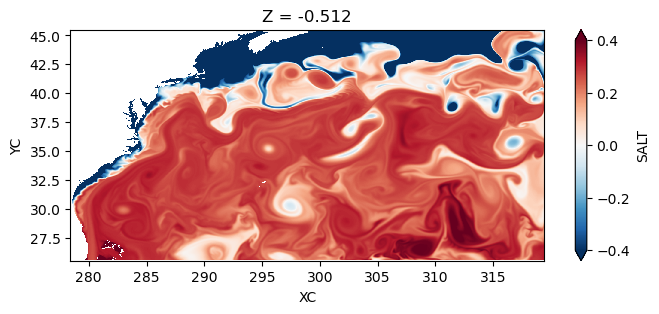

1582200


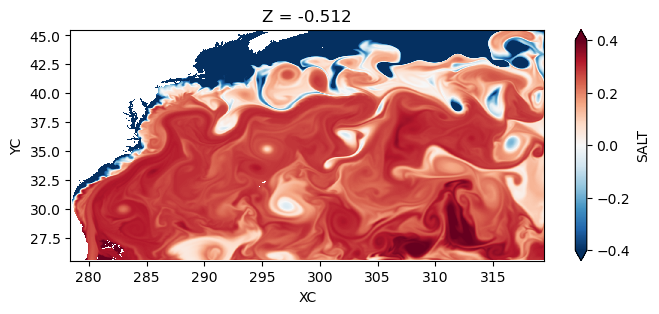

1587600


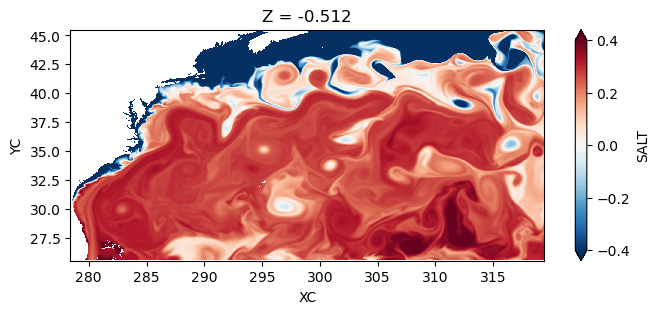

1593000


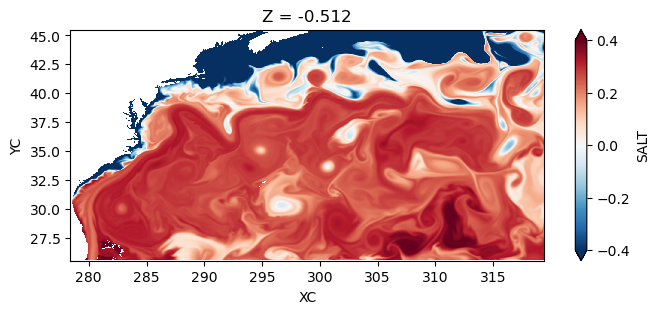

1598400


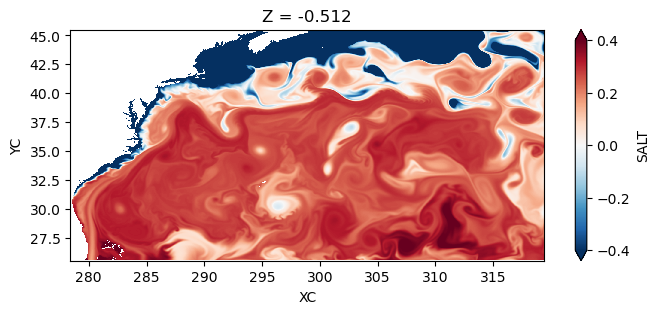

1603800


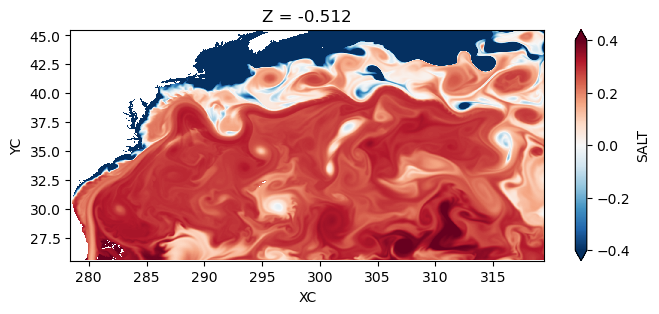

1609200


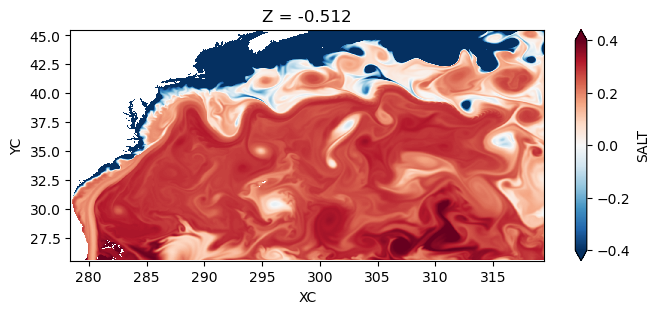

1614600


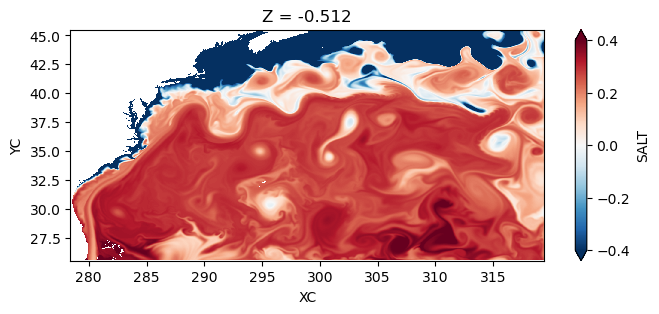

1620000


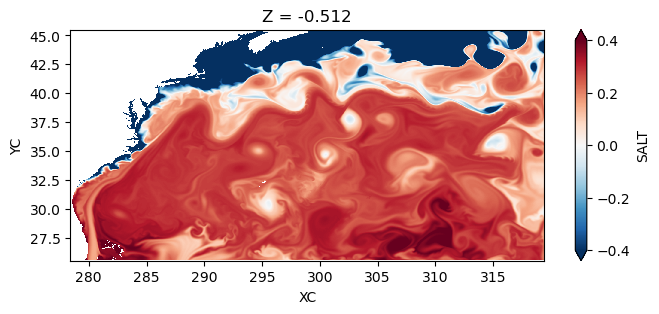

1625400


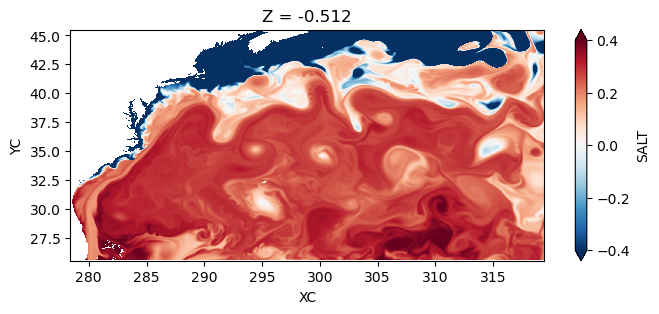

1630800


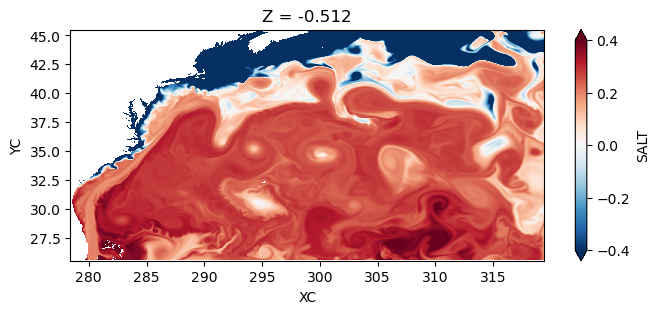

1636200


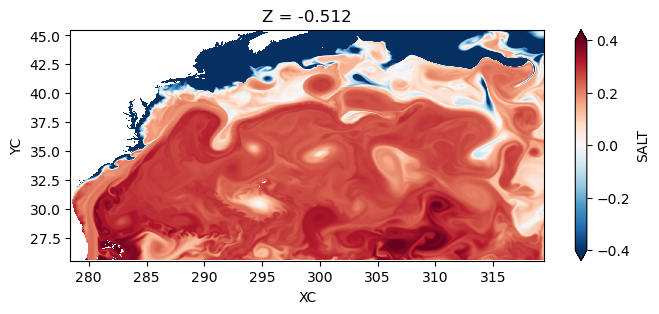

1641600


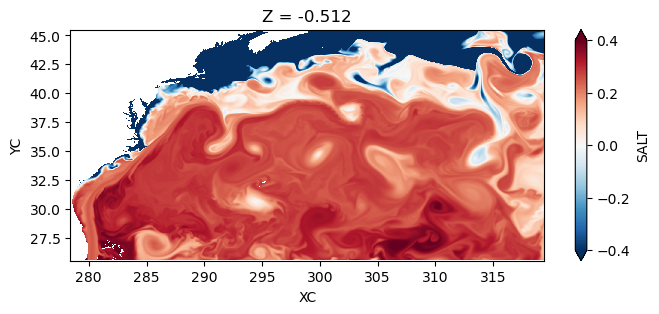

1647000


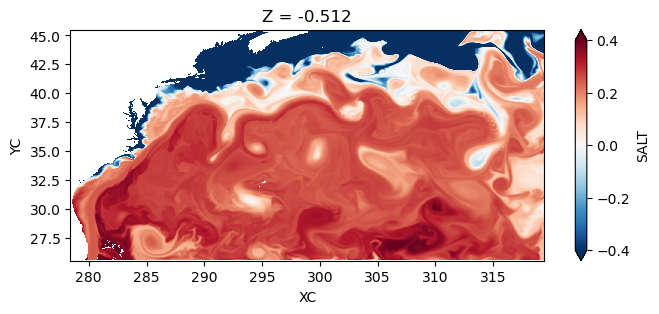

1652400


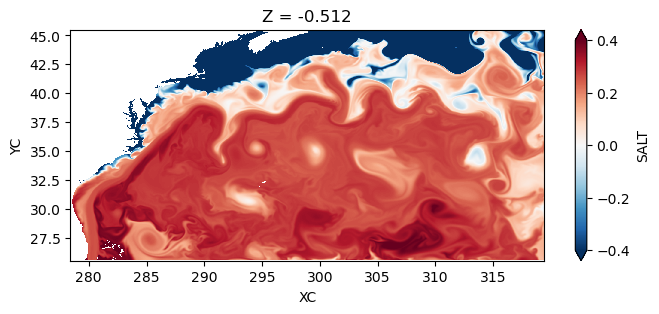

1657800


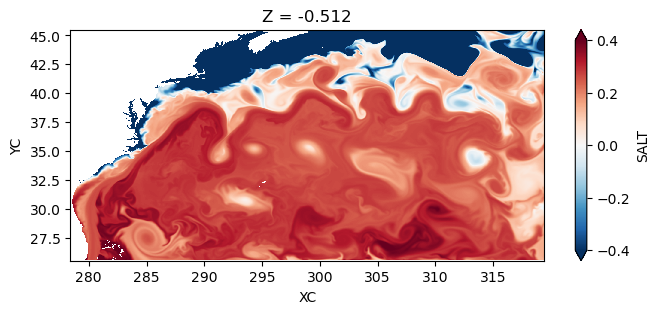

1663200


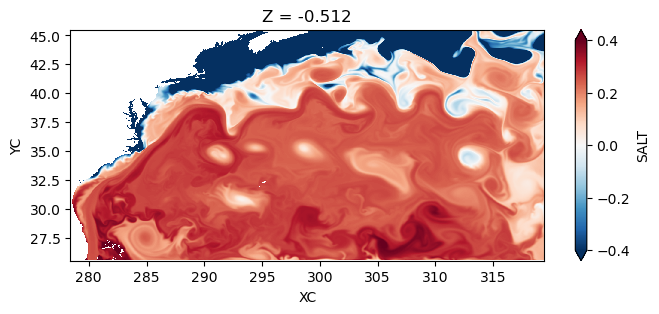

1668600


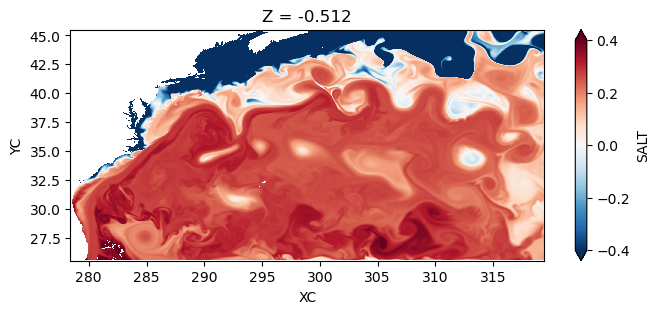

1674000


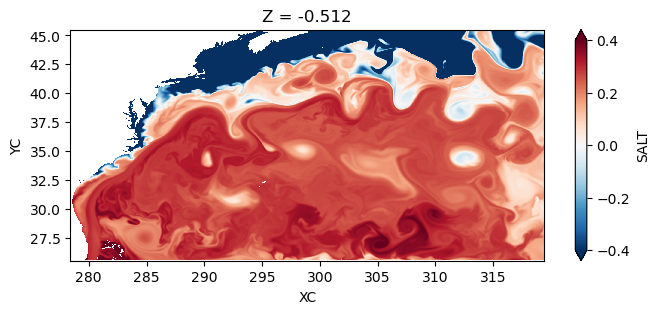

1679400


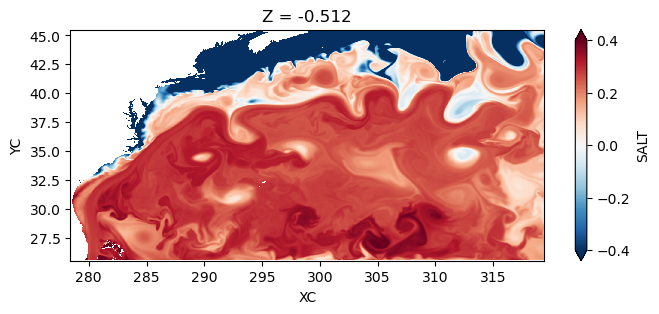

1684800


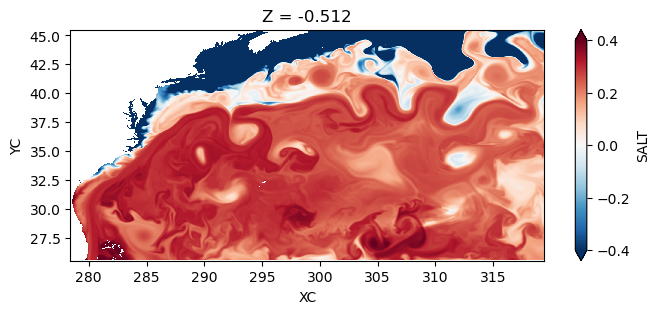

1690200


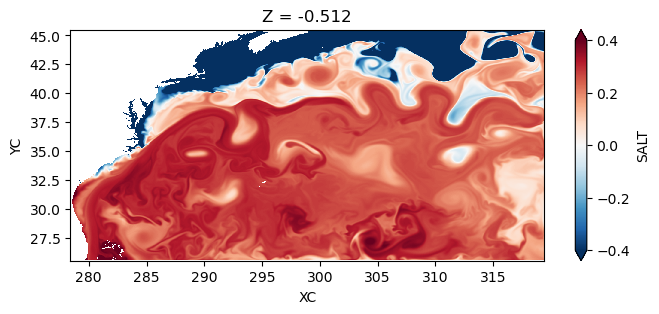

1695600


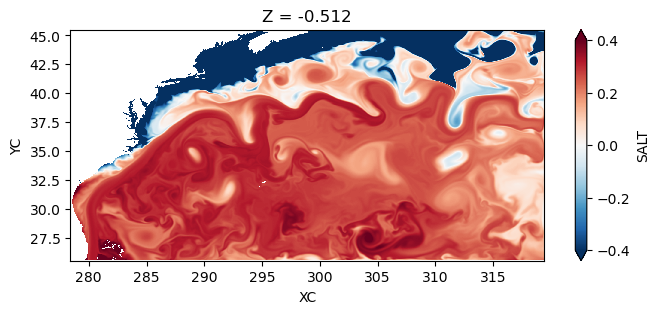

1701000


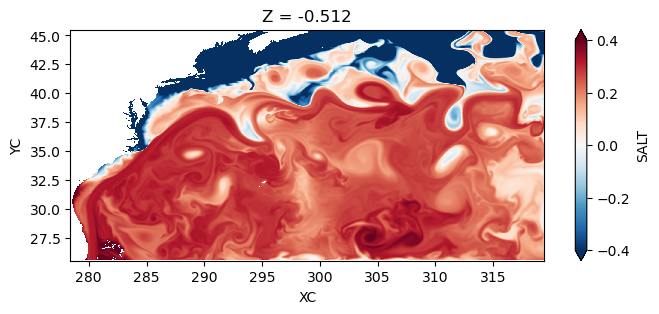

1706400


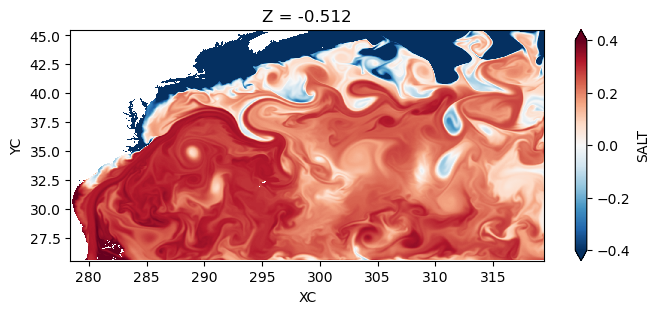

1711800


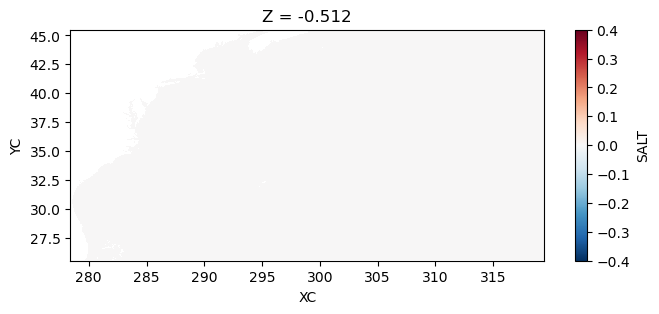

1717200


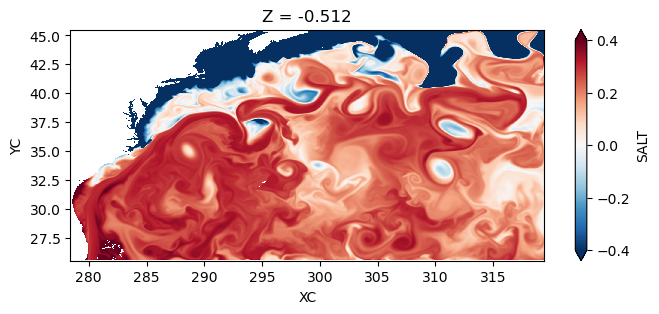

1722600


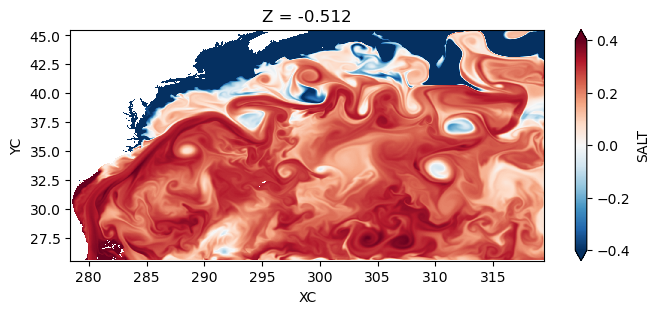

1728000


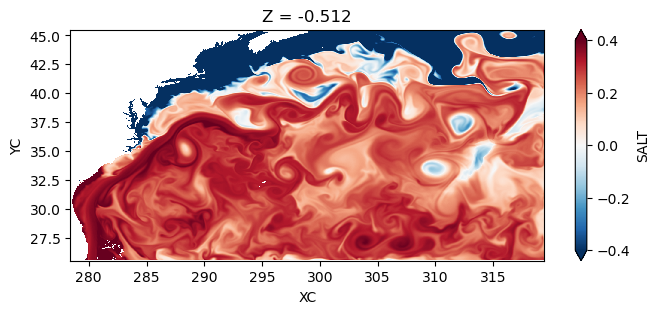

1733400


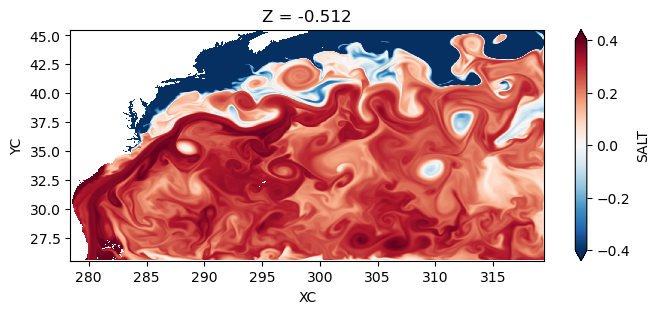

1738800


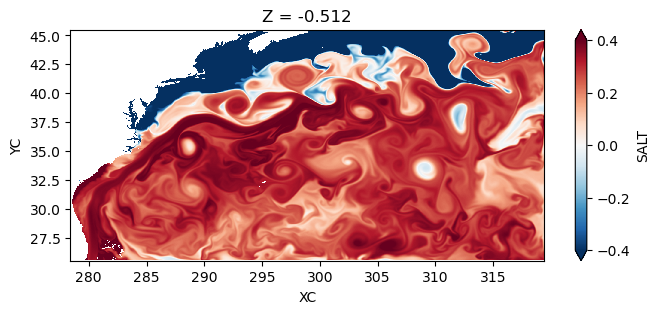

1744200


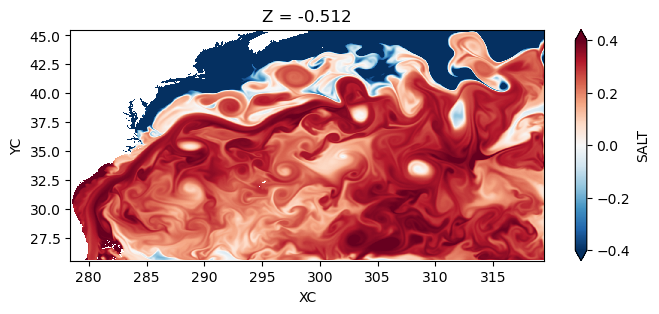

1749600


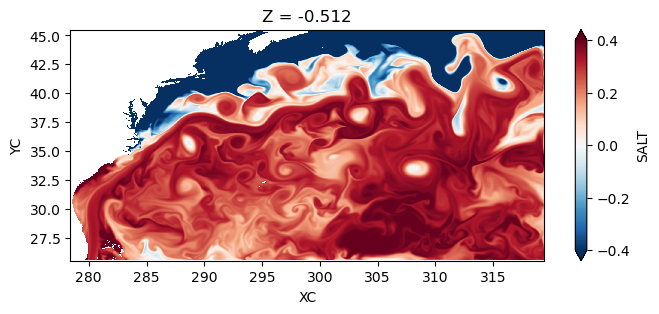

1755000


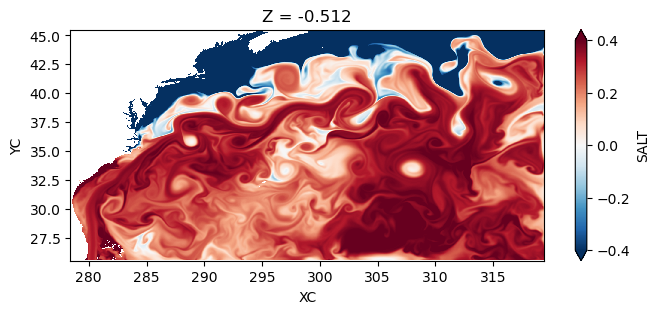

1760400


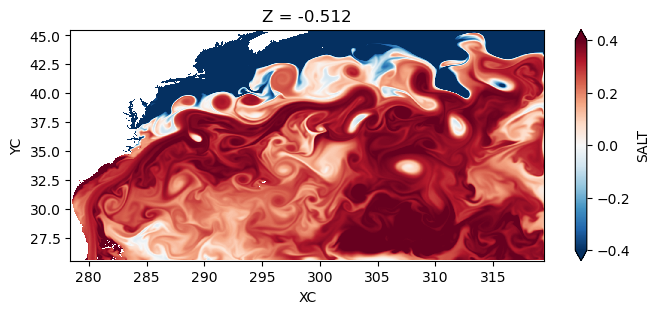

1765800


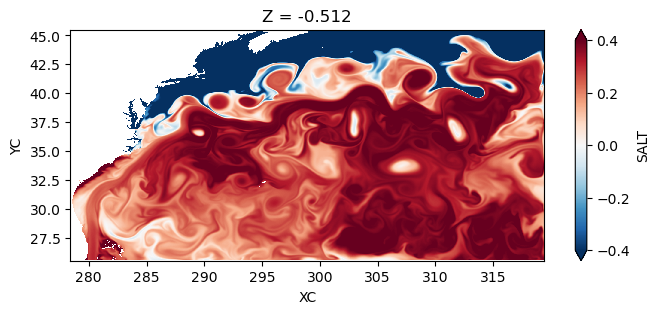

1771200


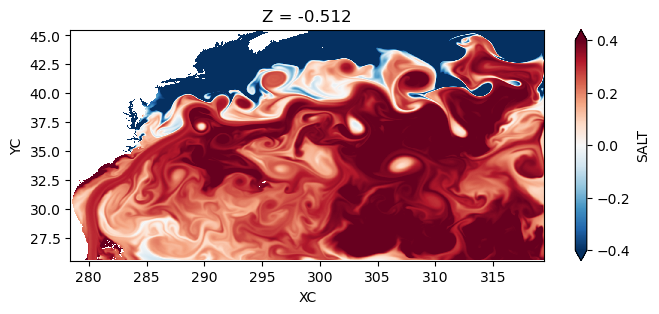

1776600


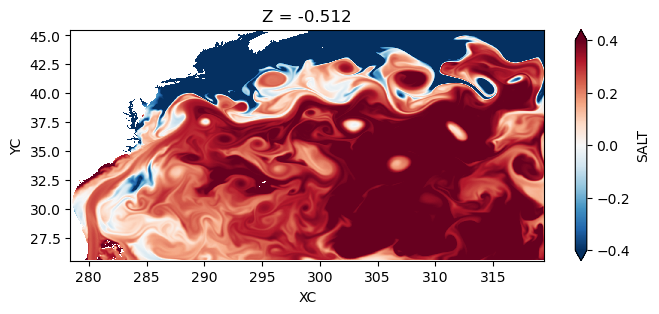

1782000


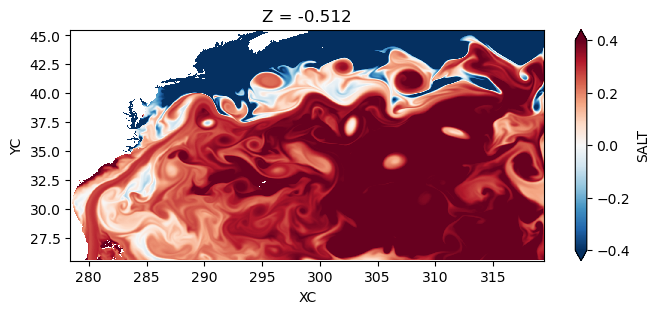

1787400


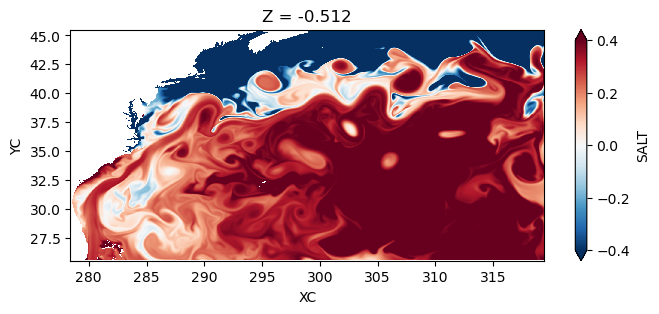

1792800


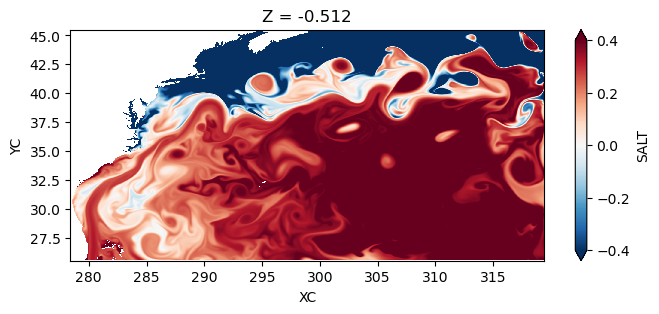

1798200


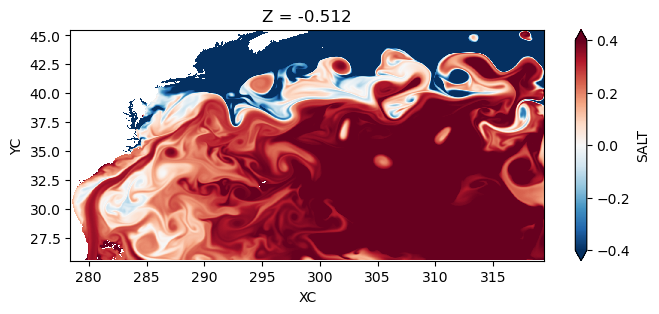

1803600


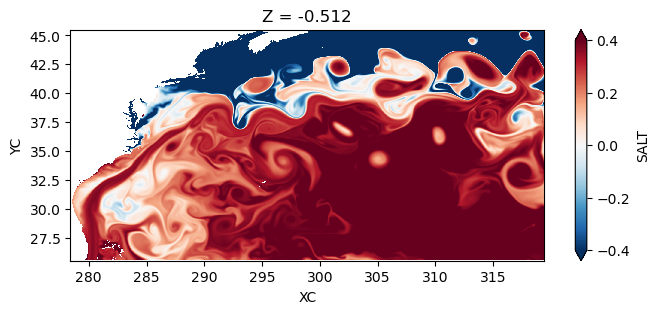

1809000


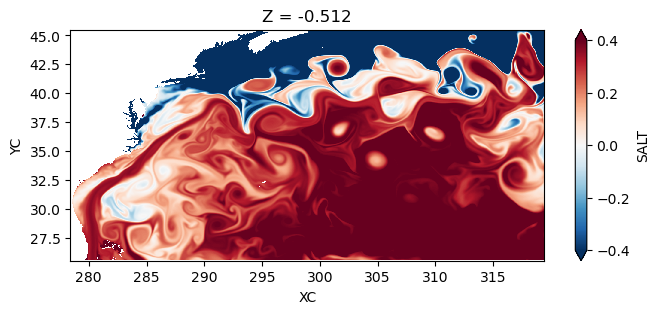

1814400


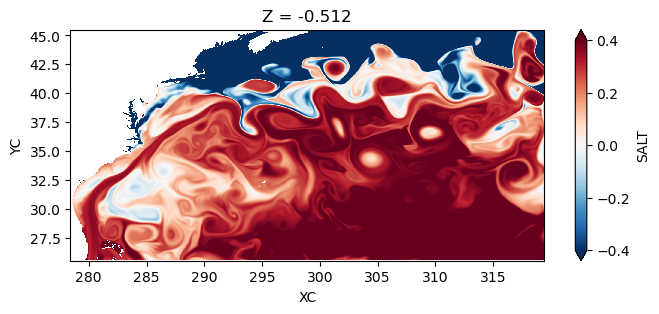

1819800


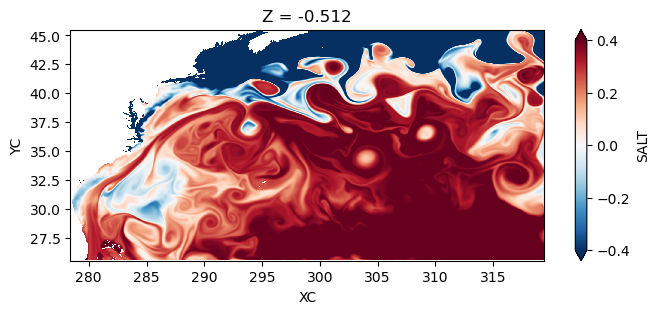

1825200


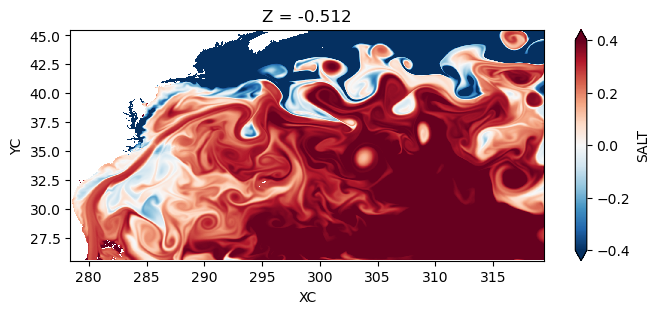

1830600


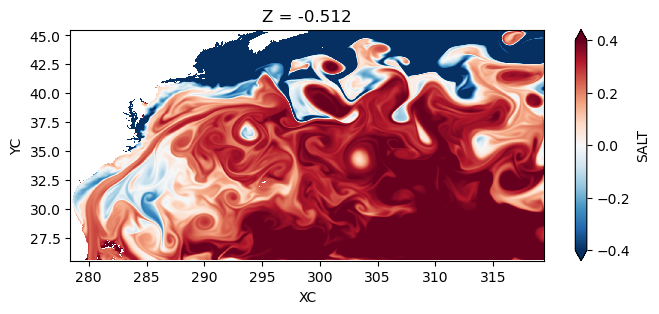

1836000


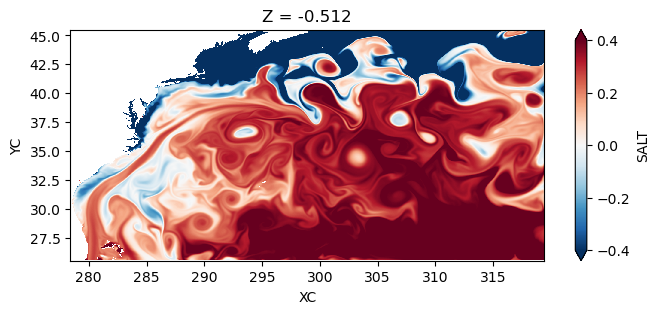

1841400


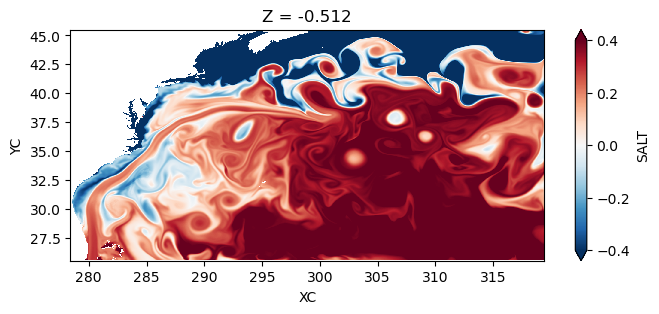

1846800


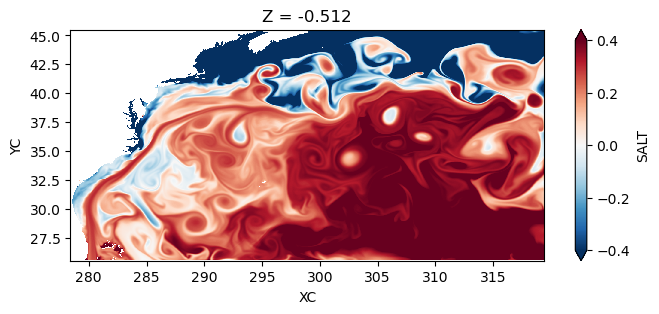

1852200


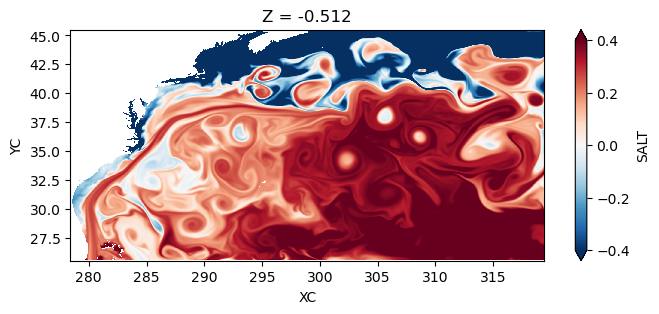

1857600


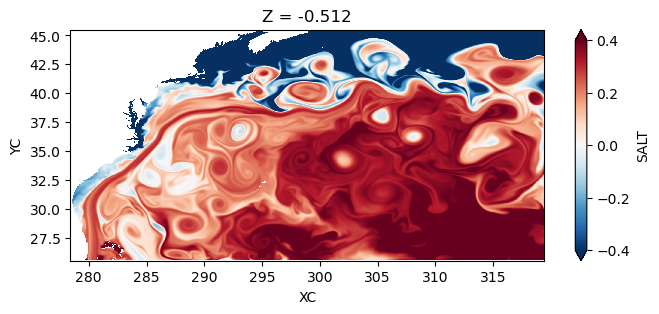

1863000


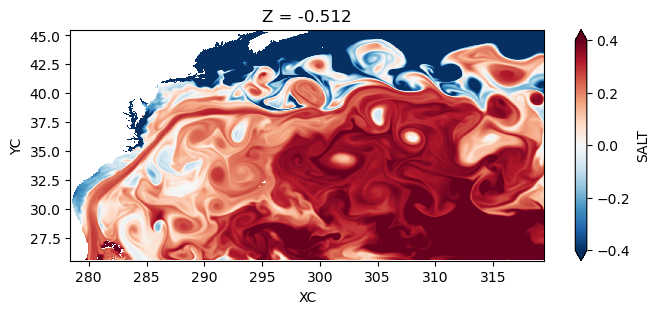

1868400


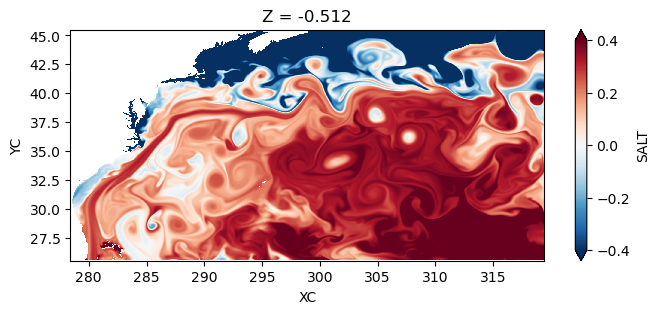

1873800


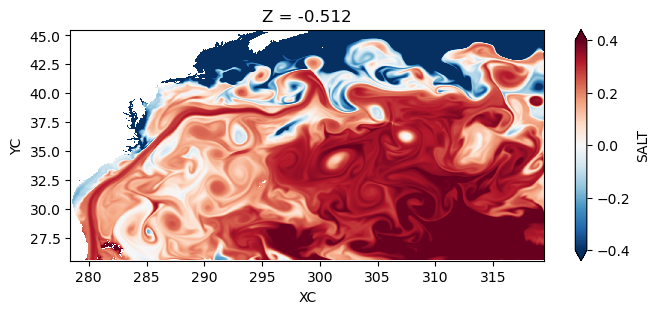

1879200


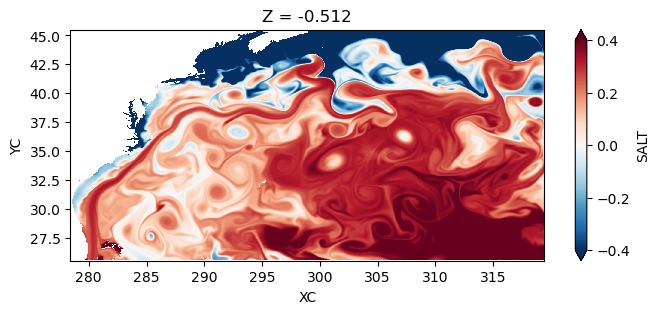

1884600


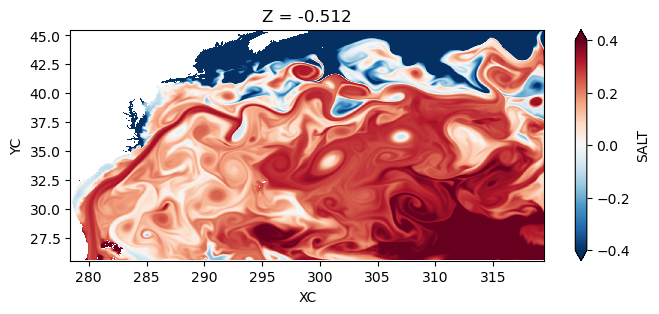

1890000


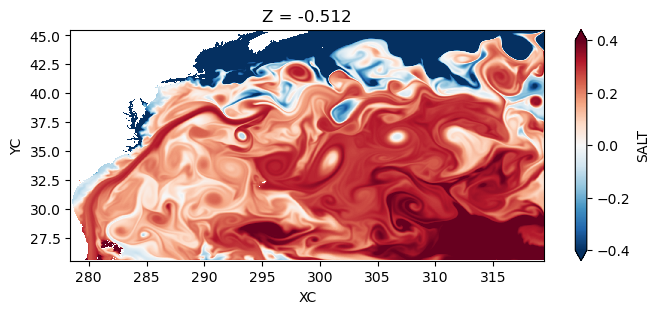

1895400


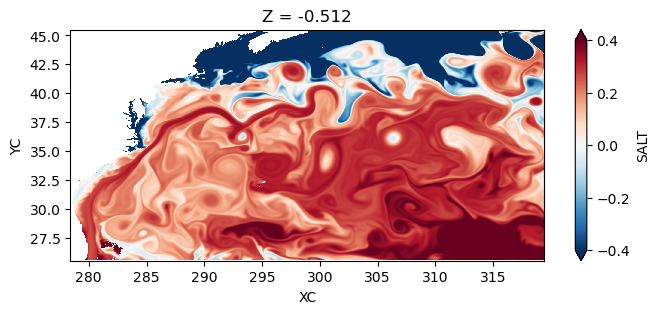

1900800


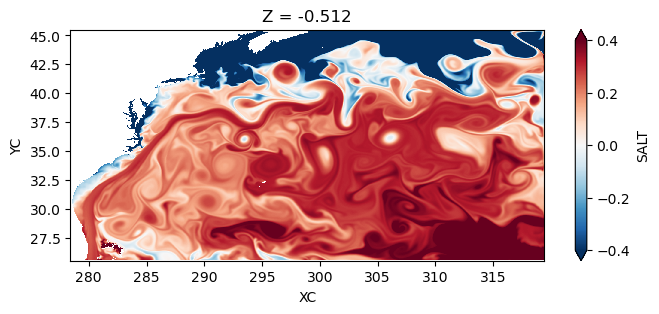

1906200


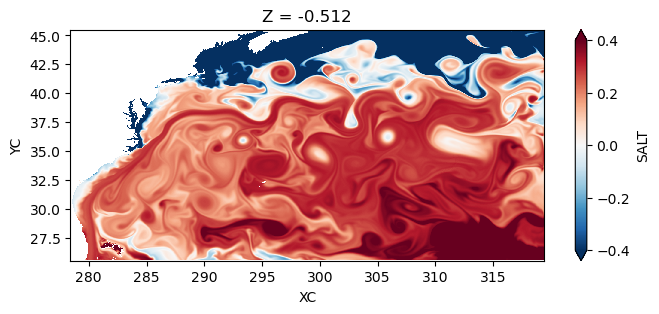

1911600


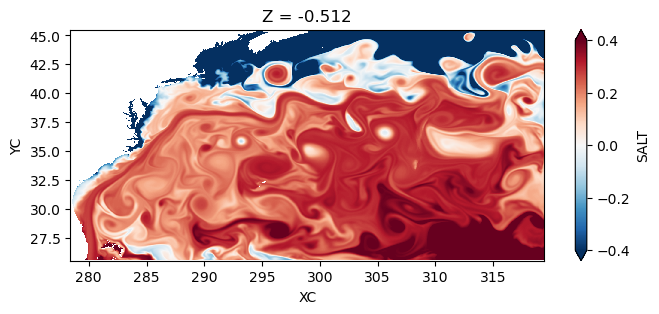

1917000


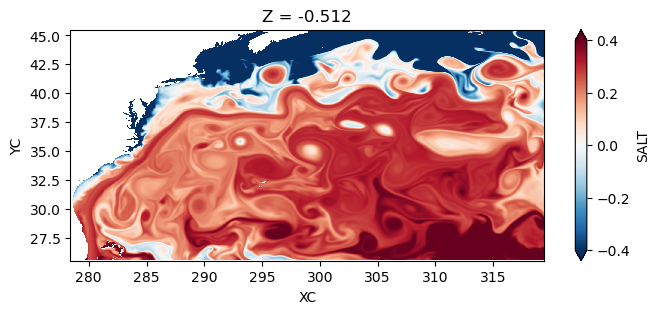

1922400


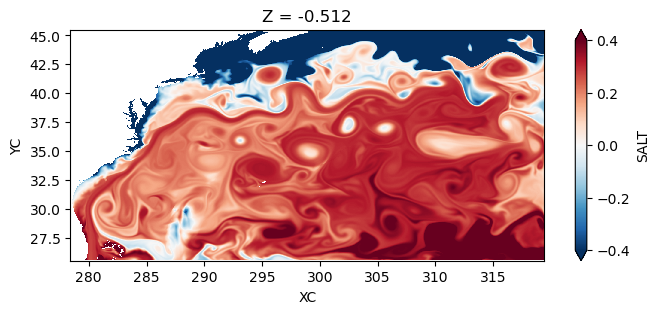

1927800


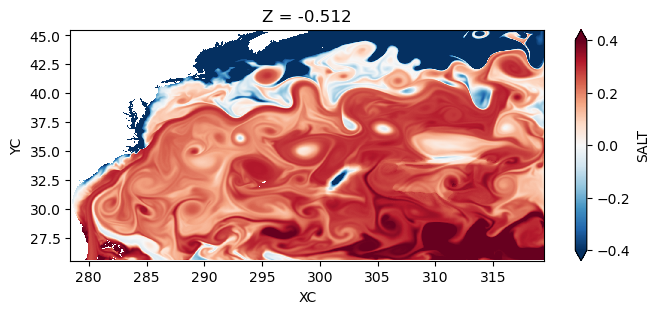

1933200


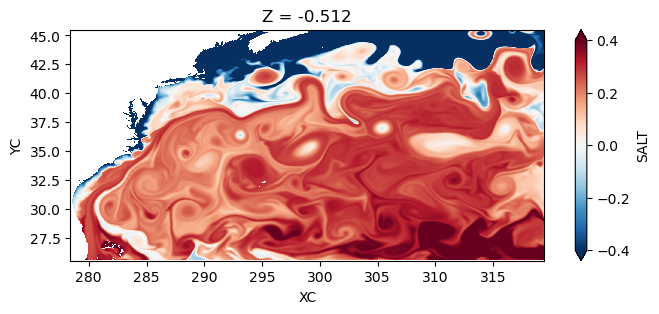

1938600


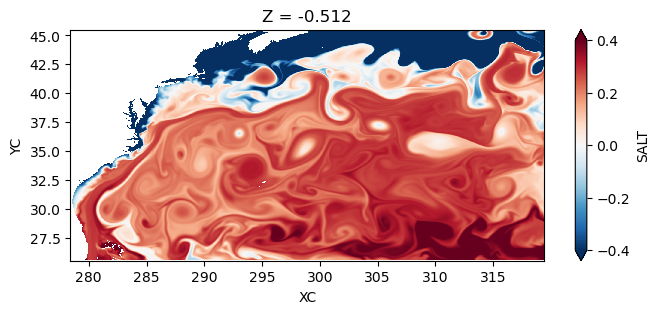

1944000


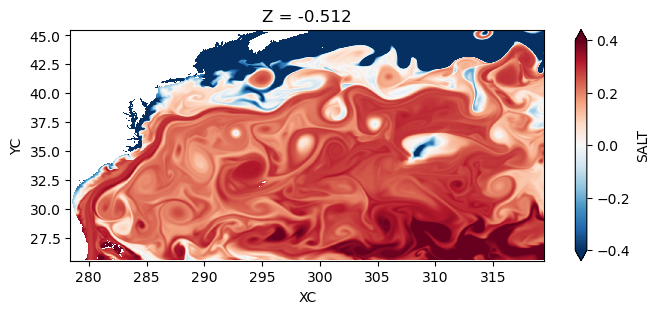

1949400


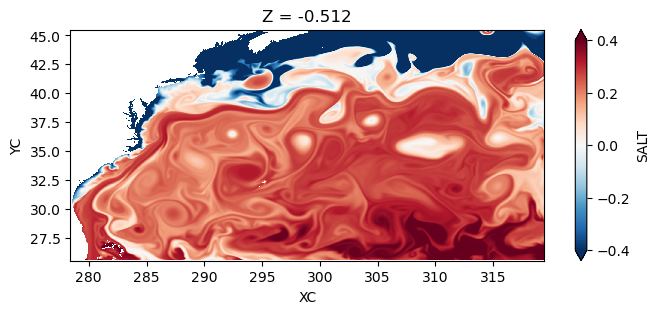

1954800


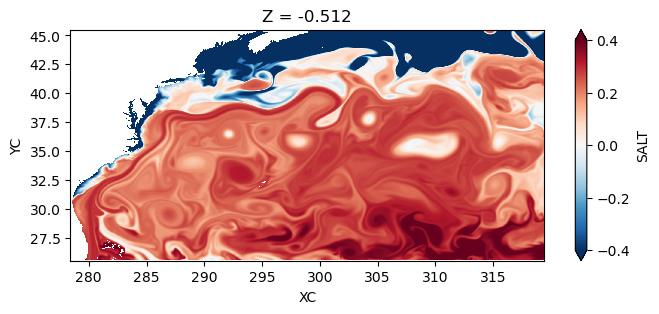

1960200


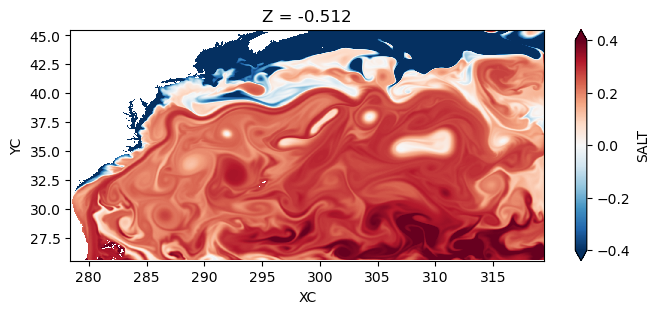

1965600


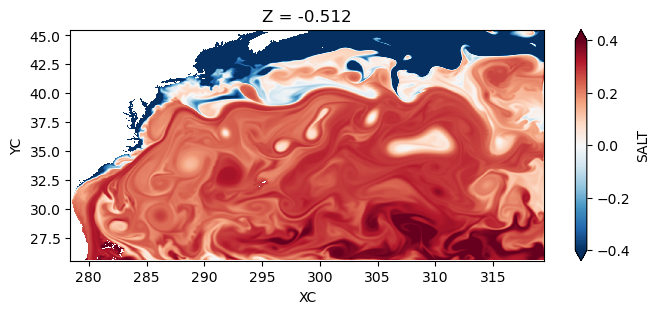

1971000


In [17]:
md = 7
for ii in iters[:]:
        
    ds = xr.open_zarr(op.join(ddir,'%4d/memb%03d/Snap%010i.zarr' 
                              % (iper,md,ii))
                     )

    fig, ax = plt.subplots(figsize=(8,3))
    (ds.SALT.isel(Z=0).where(dsg.maskInC!=0.)
     - ds.SALT.isel(Z=0).where(dsg.maskInC!=0.).mean(skipna=True)
    ).plot(ax=ax,rasterized=True, vmax=.4, vmin=-.4, cmap='RdBu_r')
    ax.set_aspect('equal')
    plt.show()
    ds.close()
    print(ii)
        
        # print(md)

In [18]:
# ds = xr.open_zarr(op.join(ddir,'%4d/memb%03d/Snap%010i.zarr' 
#                             % (iper,0,iters[0])),
#                  )
ds = xr.open_zarr(op.join(ddir,'%4d/memb%03d/continuity/Snap_cheapAML%010i.zarr' 
                            % (iper,0,iters[0])),
                 )
ds

<xarray.Dataset>
Dimensions:   (YC: 1000, XC: 2052)
Coordinates:
  * XC        (XC) float32 278.4 278.4 278.5 278.5 ... 319.4 319.4 319.4 319.4
  * YC        (YC) float32 25.51 25.53 25.55 25.57 ... 45.43 45.45 45.47 45.49
Data variables:
    Qair      (YC, XC) float32 dask.array<chunksize=(100, 100), meta=np.ndarray>
    Tair      (YC, XC) float32 dask.array<chunksize=(100, 100), meta=np.ndarray>
    gQairNm1  (YC, XC) float32 dask.array<chunksize=(100, 100), meta=np.ndarray>
    gTairNm1  (YC, XC) float32 dask.array<chunksize=(100, 100), meta=np.ndarray>

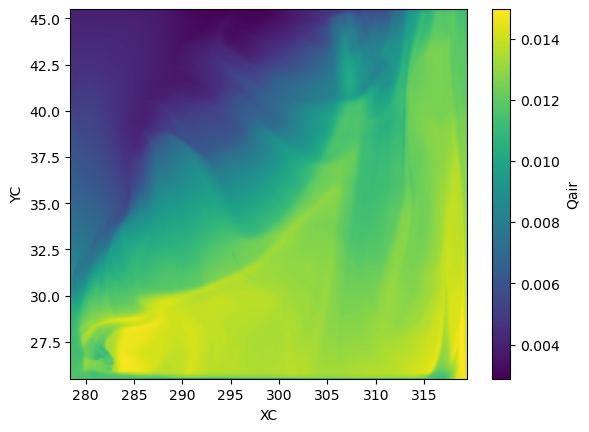

In [19]:
ds.Qair.plot()

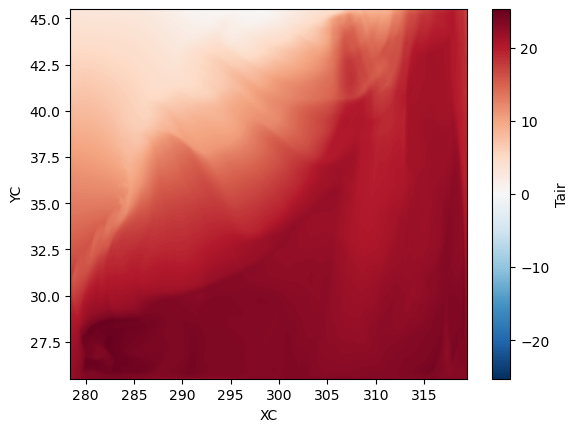

In [20]:
ds.Tair.plot()